In [1]:
import csv
import pandas as pd
import plotly.express as px

# Объекты спроса

In [2]:
df = pd.read_csv("2021-04-01_low.csv")
split_data = df.gps.str.strip(')').str.strip('(').str.split(', ')
df['lat'] = split_data.apply(lambda x: x[0])
df['long'] = split_data.apply(lambda x: x[1])

In [3]:
df.head(20)

,ts,ap_mac,device_id,user_id,gps,lat,long
0,2021-04-03 11:55:57+00:00,1CB9C429BB30,3865307a9074a57d016044f460ff2f5d,NaN,"(55.73100280761719, 37.6336669921875)",55.73100280761719,37.6336669921875
1,2021-04-03 11:55:57+00:00,EC8CA22EE0D0,4d13cfdce010ca3a449811e659c7cae9,NaN,"(55.74755096435547, 37.595062255859375)",55.74755096435547,37.595062255859375
2,2021-04-03 11:55:57+00:00,EC8CA22F0D20,e1b4a469c65972d9806ced5b78c32068,NaN,"(55.728275299072266, 37.62435531616211)",55.728275299072266,37.62435531616211
3,2021-04-03 11:55:58+00:00,1CB9C429D520,9c9034daf111f04006f8e6a06d2042d7,NaN,"(55.747676849365234, 37.59743118286133)",55.747676849365234,37.59743118286133
4,2021-04-03 11:55:58+00:00,0CF4D52D4060,425c425bbb80b322d62193265aac62d1,NaN,"(55.72984313964844, 37.59235382080078)",55.72984313964844,37.59235382080078
5,2021-04-03 11:55:58+00:00,1CB9C4251330,02891bdd012829efe31ed1ec1c15de42,NaN,"(55.737823486328125, 37.62553405761719)",55.737823486328125,37.62553405761719
6,2021-04-03 11:55:58+00:00,0CF4D52C4A70,ab594fb98166474190c6ff0707e7752e,NaN,"(55.72039031982422, 37.57209396362305)",55.72039031982422,37.57209396362305
7,2021-04-03 11:55:58+00:00,1CB9C426D130,1e6a80707c261f6d34da02b8c07c6663,NaN,"(55.73089599609375, 37.609928131103516)",55.73089599609375,37.609928131103516
8,2021-04-03 11:55:58+00:00,0CF4D52D4060,425c425bbb80b322d62193265aac62d1,NaN,"(55.72984313964844, 37.59235382080078)",55.72984313964844,37.59235382080078
9,2021-04-03 11:55:58+00:00,1CB9C4251330,02891bdd012829efe31ed1ec1c15de42,NaN,"(55.737823486328125, 37.62553405761719)",55.737823486328125,37.62553405761719


In [4]:
df.columns

Index(['ts', 'ap_mac', 'device_id', 'user_id', 'gps', 'lat', 'long'], dtype='object')

In [5]:
#df.groupby([['ap_mac','ts']]).size()

In [6]:
df.groupby(['gps']).size()

gps
(55.655155181884766, 37.75764846801758)      11256
(55.655540466308594, 37.758636474609375)     11062
(55.65578079223633, 37.75920104980469)       16563
(55.65694046020508, 37.75919723510742)       10333
(55.65735626220703, 37.75857925415039)       16405
                                             ...  
(55.753028869628906, 37.64451599121094)      29320
(55.7530403137207, 37.55640411376953)       102390
(55.75309753417969, 37.586544036865234)      17632
(55.75313949584961, 37.58657455444336)       34533
(55.753211975097656, 37.59275436401367)      12884
Length: 1477, dtype: int64

In [7]:
#df.groupby(['gps']).plot()

In [8]:
df.groupby(['user_id']).size()

user_id
0001a587f4dcdc9d31685d8b8d9a9272     10
0002f0e6e80017407bbf5b249ca16d8f      3
0003a32d846e5379e688755d308e124f    174
000757f2e8927139b3c006288ececc12     27
00076ca7ea5608f3bbc61d2ffd4c7832     41
                                   ... 
fff74880fe93eb2d89e4548d34138603    146
fff93294492b868cfd21782402d9870f     71
fff9b265dea25617837ba02c1d352344      6
fffaef1ddaea311add630042097e24cf      6
fffccb76d1765ebe28f336639b592a67     11
Length: 34019, dtype: int64

In [9]:
df.groupby(['device_id']).size()

device_id
000000f0e253a51e8f8536c0eab88ba5    164
000004abff6d35eb404c3762b3a0d385     22
000007a3cbd85996ca5ada6a13ae601e     54
00002b77004aa2cb6d75c1d0e71bcd28     18
00002fe4cc42fa1c768f4d99c2e2f566      6
                                   ... 
ffffcd0e16d57ca0134ff1e68fa032dc     44
ffffd0e05d25cf9d0b3d24219f85cad0      2
ffffd1a6623502cef29a700e4ad5be8e     10
ffffd3816ebd2299e1f2ce7e486f6fc9    377
ffffd9ee5c9e137dc0776a0805a61000    110
Length: 794761, dtype: int64

In [10]:
groupbycoord=df.groupby(['lat', 'long']).size()
print(groupbycoord)

lat                 long              
55.655155181884766  37.75764846801758      11256
55.655540466308594  37.758636474609375     11062
55.65578079223633   37.75920104980469      16563
55.65694046020508   37.75919723510742      10333
55.65735626220703   37.75857925415039      16405
                                           ...  
55.753028869628906  37.64451599121094      29320
55.7530403137207    37.55640411376953     102390
55.75309753417969   37.586544036865234     17632
55.75313949584961   37.58657455444336      34533
55.753211975097656  37.59275436401367      12884
Length: 1477, dtype: int64


In [11]:
groupbycoord2 = groupbycoord.reset_index(name="count")
print(groupbycoord2.columns)
print(groupbycoord2)

Index(['lat', 'long', 'count'], dtype='object')
                     lat                long   count
0     55.655155181884766   37.75764846801758   11256
1     55.655540466308594  37.758636474609375   11062
2      55.65578079223633   37.75920104980469   16563
3      55.65694046020508   37.75919723510742   10333
4      55.65735626220703   37.75857925415039   16405
...                  ...                 ...     ...
1472  55.753028869628906   37.64451599121094   29320
1473    55.7530403137207   37.55640411376953  102390
1474   55.75309753417969  37.586544036865234   17632
1475   55.75313949584961   37.58657455444336   34533
1476  55.753211975097656   37.59275436401367   12884

[1477 rows x 3 columns]


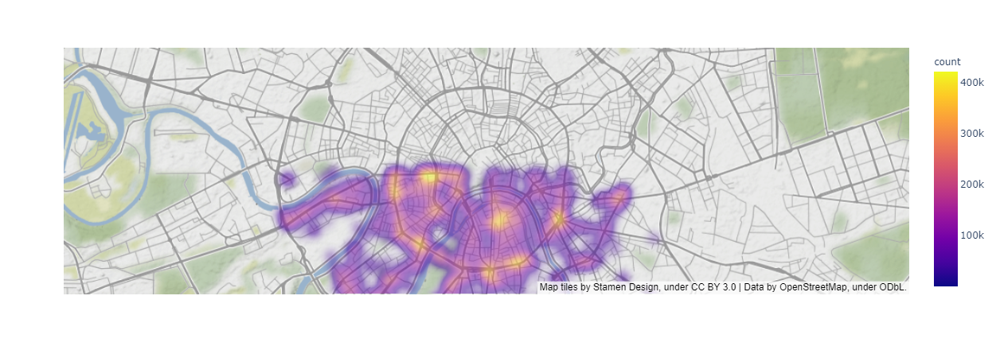

In [18]:
fig = px.density_mapbox(groupbycoord2, lat='lat', lon='long', z='count', radius=20,
                        center=dict(lat=55.753523766159674, lon=37.62248054041811), zoom=11,
                        mapbox_style="stamen-terrain", opacity=0.5)
fig.show()

# Объекты предложения

In [19]:
retail_df = pd.read_json("shops.json",encoding="cp1251")
cafe_df = pd.read_json("cafes.json",encoding="cp1251")

cafe_df['SeatsCount'] = -100.0*cafe_df['SeatsCount']
cafe_df=cafe_df.rename(columns={"Latitude_WGS84":"lat","Longitude_WGS84":"long","SeatsCount":"count"})

retail_df=retail_df.rename(columns={"Latitude_WGS84":"lat","Longitude_WGS84":"long","SeatsCount":"count"})

#retail_df.head()
cafe_df.head()

,ID,Name,global_id,IsNetObject,OperatingCompany,TypeObject,AdmArea,District,Address,PublicPhone,count,SocialPrivileges,long,lat,geoData,geodata_center
0,151635,СМЕТАНА,637376221,нет,,кафе,Северо-Восточный административный округ,Ярославский район,"город Москва, улица Егора Абакумова, дом 9",[{'PublicPhone': '(499) 183-14-10'}],-4800.0,нет,37.714565,55.879002,"{'coordinates': [37.714565000436, 55.879001531...","{'type': 'geometry', 'value': '010100000098DEA..."
1,77874,Родник,637376331,нет,,кафе,Центральный административный округ,Таганский район,"город Москва, улица Талалихина, дом 2/1, корпус 1",[{'PublicPhone': '(495) 676-55-35'}],-3500.0,нет,37.673306,55.738239,"{'coordinates': [37.6733061300344, 55.73823865...","{'type': 'geometry', 'value': '0101000000D7583..."
2,24309,Кафе «Академия»,637376349,нет,,кафе,Центральный административный округ,Таганский район,"город Москва, Абельмановская улица, дом 6",[{'PublicPhone': '(495) 662-30-10'}],-9500.0,нет,37.669648,55.735511,"{'coordinates': [37.6696475969381, 55.73551147...","{'type': 'geometry', 'value': '0101000000D9583..."
3,27429,ГБОУ «Школа № 1430 имени Героя Социалистическо...,637376480,нет,,столовая,Северо-Восточный административный округ,район Лианозово,"город Москва, Угличская улица, дом 17",[{'PublicPhone': '(499) 908-06-15'}],-24000.0,нет,37.566940,55.904019,"{'coordinates': [37.56694, 55.9040188006692], ...","{'type': 'geometry', 'value': '0101000000AA656..."
4,148815,Брусника,637376481,да,Брусника,кафе,Центральный административный округ,район Арбат,"город Москва, переулок Сивцев Вражек, дом 6/2",[{'PublicPhone': '(495) 697-04-89'}],-1000.0,нет,37.598128,55.747390,"{'coordinates': [37.59812754844, 55.7473904905...","{'type': 'geometry', 'value': '010100000076B18..."


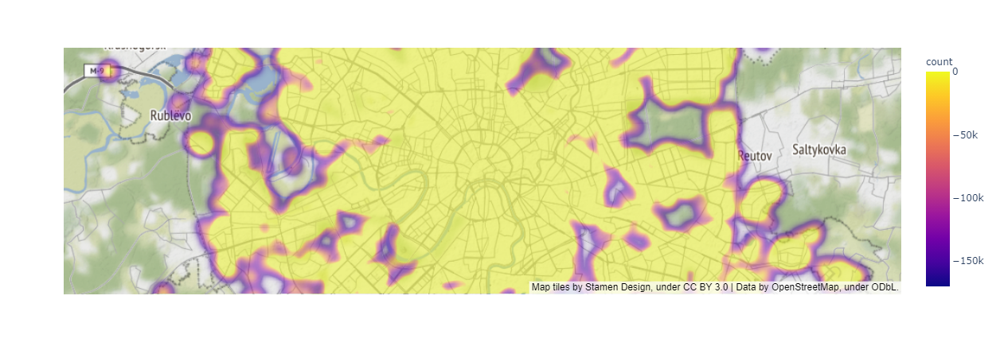

In [20]:
fig = px.density_mapbox(cafe_df, lat='lat', lon='long', z='count', radius=20,
                        center=dict(lat=55.753523766159674, lon=37.62248054041811), zoom=10,
                        mapbox_style="stamen-terrain", opacity=0.5)
fig.show()

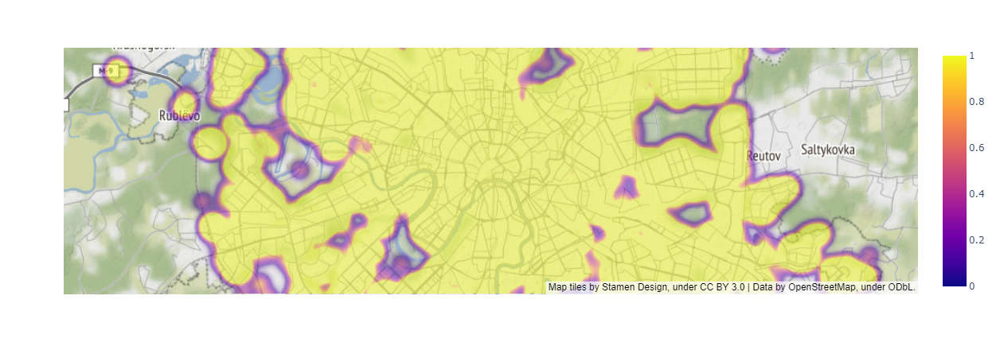

In [21]:
fig = px.density_mapbox(retail_df, lat='lat', lon='long', radius=20,
                        center=dict(lat=55.753523766159674, lon=37.62248054041811), zoom=10,
                        mapbox_style="stamen-terrain", opacity=0.5)
fig.show()

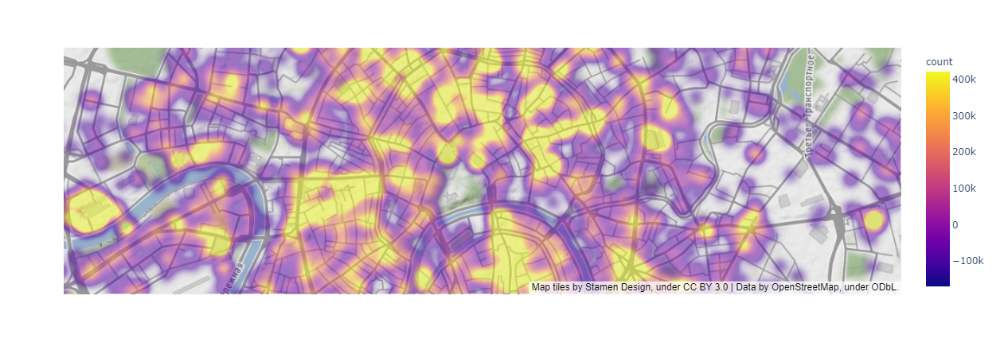

In [22]:
combined_df=pd.concat([cafe_df[['lat','long', 'count']], groupbycoord2])
#cafe_df[['lat','long', 'count']]
fig = px.density_mapbox(combined_df, lat='lat', lon='long', z='count', radius=20,
                        center=dict(lat=55.753523766159674, lon=37.62248054041811), zoom=12,
                        mapbox_style="stamen-terrain", opacity=0.5)
fig.show()

# Kernel Density (Plotly)

In [23]:
from sklearn import datasets
import seaborn as sns #!pip install seaborn

ModuleNotFoundError: No module named 'seaborn'

In [24]:
#!pip install --upgrade pip=="21.1.2"
!pip install seaborn

You should consider upgrading via the 'c:\python39\python.exe -m pip install --upgrade pip' command.


In [25]:
import plotly.express as px
data_tips = px.data.tips()
data_tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


In [26]:
groupbycoord2.head()
groupbycoord2.dtypes

lat      object
long     object
count     int64
dtype: object

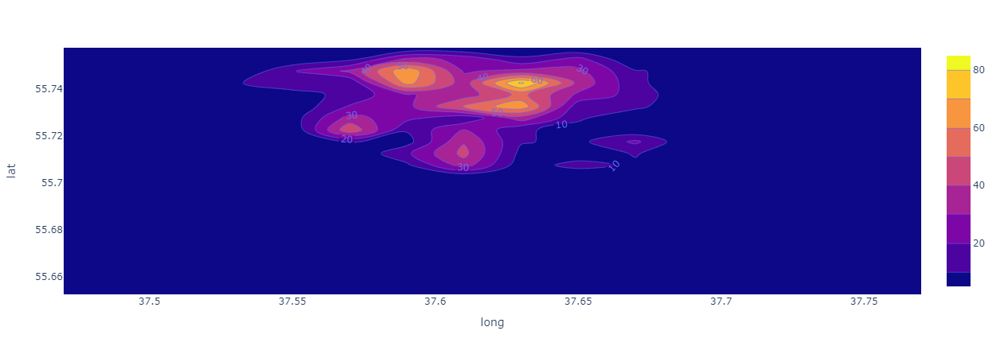

In [27]:
#fig = px.density_contour(combined_df.astype({'long': 'float', 'lat':'float', 'count':'int32'}), x='long', y='lat', z='count')
#fig = px.density_contour(cafe_df.astype({'long': 'float', 'lat':'float', 'count':'int32'}), x='long', y='lat', z='count')
fig = px.density_contour(groupbycoord2.astype({'long': 'float', 'lat':'float', 'count':'int32'}), x='long', y='lat', z='count')
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.show()

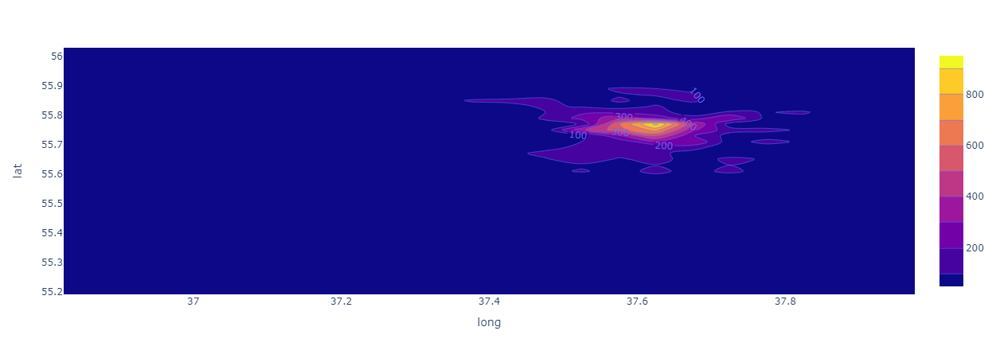

In [28]:
#fig = px.density_contour(combined_df.astype({'long': 'float', 'lat':'float', 'count':'int32'}), x='long', y='lat', z='count')
fig = px.density_contour(cafe_df.astype({'long': 'float', 'lat':'float', 'count':'int32'}), x='long', y='lat', z='count')
#fig = px.density_contour(groupbycoord2.astype({'long': 'float', 'lat':'float', 'count':'int32'}), x='long', y='lat', z='count')
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.show()
#cafe_df.astype({'long': 'float', 'lat':'float', 'count':'int32'}).head()

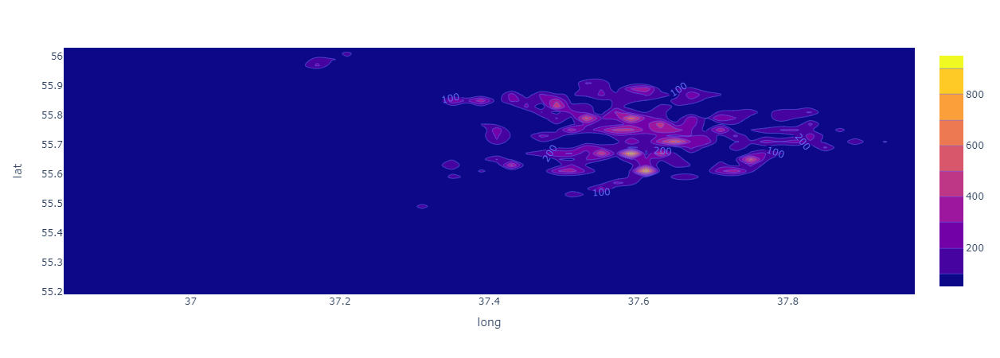

In [29]:
#fig = px.density_contour(combined_df.astype({'long': 'float', 'lat':'float', 'count':'int32'}), x='long', y='lat', z='count')
#fig = px.density_contour(cafe_df.astype({'long': 'float', 'lat':'float', 'count':'int32'}), x='long', y='lat', z='count')
fig = px.density_contour(retail_df.astype({'long': 'float', 'lat':'float'}), x='long', y='lat')
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.show()

# Интерполяция неструктурированных данных

In [30]:
from scipy.interpolate import griddata
import numpy as np

In [45]:
min_lat = groupbycoord2['lat'].astype(np.double).min()
max_lat = groupbycoord2['lat'].astype(np.double).max()
min_lon = groupbycoord2['long'].astype(np.double).min()
max_lon = groupbycoord2['long'].astype(np.double).max()

print(min_lat, max_lat, min_lon, max_lon)

#target_grid_x, target_grid_y = np.mgrid[min_lat:0.0001:max_lat*1j, min_lon:0.0001:max_lon*1j]
#print(target_grid_x.shape)
#print(target_grid_y.shape)
arange_x =  np.arange(min_lon,max_lon,step=0.001, dtype=np.double)
print(arange_x.shape)

arange_y = np.arange(min_lat,max_lat,step=0.001, dtype=np.double)
print(arange_y.shape)

target_grid_x, target_grid_y = np.meshgrid(arange_x, arange_y)

print(target_grid_x.shape)
print(target_grid_y.shape)


55.655155181884766 55.753211975097656 37.49541473388672 37.75920104980469
(264,)
(99,)
(99, 264)
(99, 264)


In [46]:
target_grid_x

array([[37.49541473, 37.49641473, 37.49741473, ..., 37.75641473,
        37.75741473, 37.75841473],
       [37.49541473, 37.49641473, 37.49741473, ..., 37.75641473,
        37.75741473, 37.75841473],
       [37.49541473, 37.49641473, 37.49741473, ..., 37.75641473,
        37.75741473, 37.75841473],
       ...,
       [37.49541473, 37.49641473, 37.49741473, ..., 37.75641473,
        37.75741473, 37.75841473],
       [37.49541473, 37.49641473, 37.49741473, ..., 37.75641473,
        37.75741473, 37.75841473],
       [37.49541473, 37.49641473, 37.49741473, ..., 37.75641473,
        37.75741473, 37.75841473]])

In [47]:
target_grid_y

array([[55.65515518, 55.65515518, 55.65515518, ..., 55.65515518,
        55.65515518, 55.65515518],
       [55.65615518, 55.65615518, 55.65615518, ..., 55.65615518,
        55.65615518, 55.65615518],
       [55.65715518, 55.65715518, 55.65715518, ..., 55.65715518,
        55.65715518, 55.65715518],
       ...,
       [55.75115518, 55.75115518, 55.75115518, ..., 55.75115518,
        55.75115518, 55.75115518],
       [55.75215518, 55.75215518, 55.75215518, ..., 55.75215518,
        55.75215518, 55.75215518],
       [55.75315518, 55.75315518, 55.75315518, ..., 55.75315518,
        55.75315518, 55.75315518]])

In [92]:
#groupbycoord2.head()
points_wifi = groupbycoord2[['lat','long']].astype(float).to_numpy()
print(points_wifi.shape)
values_wifi = groupbycoord2['count'].astype(float).to_numpy()
print(values_wifi)

points_cafe = cafe_df[['lat','long']].astype(float).to_numpy()
print(points_cafe.shape)
values_cafe = cafe_df['count'].astype(float).to_numpy()
print(values_cafe.shape)

points_retail = retail_df[['lat','long']].astype(float).to_numpy()
print(points_retail.shape)
# values_retail = retail_df['count'].astype(float).to_numpy()
# print(values_retail.shape)
groupbycoord2.head()

(1477, 2)
[11256. 11062. 16563. ... 17632. 34533. 12884.]
(17375, 2)
(17375,)
(49473, 2)


,lat,long,count
0,55.655155181884766,37.75764846801758,11256
1,55.655540466308594,37.758636474609375,11062
2,55.65578079223633,37.75920104980469,16563
3,55.65694046020508,37.75919723510742,10333
4,55.65735626220703,37.75857925415039,16405


In [93]:
#target_grid = (grid_x, grid_y)
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.interpolate.griddata.html
structured_wifi_linear = griddata(points_wifi, values_wifi, (target_grid_y, target_grid_x), method='linear')
structured_wifi_cubic = griddata(points_wifi, values_wifi, (target_grid_y, target_grid_x), method='cubic')
structured_wifi_nearest = griddata(points_wifi, values_wifi, (target_grid_y, target_grid_x), method='nearest')

In [94]:
values_wifi

array([11256., 11062., 16563., ..., 17632., 34533., 12884.])

In [95]:
structured_wifi_cubic

array([[           nan,            nan,            nan, ...,
                   nan,            nan,            nan],
       [           nan,            nan,            nan, ...,
         3895.74383578, 15413.40663969, 12083.2958157 ],
       [           nan,            nan,            nan, ...,
        22966.53536565, 20804.42884322, 16445.04994969],
       ...,
       [           nan,            nan,            nan, ...,
                   nan,            nan,            nan],
       [           nan,            nan,            nan, ...,
                   nan,            nan,            nan],
       [           nan,            nan,            nan, ...,
                   nan,            nan,            nan]])

In [96]:
structured_wifi_nearest.shape

(99, 264)

## Сплайновая кубическая интерполяция

In [88]:
import plotly.graph_objects as go

#fig = go.Figure(data = go.Contour(x =arange_x, y = arange_y, z=structured_wifi))
#fig = go.Figure(data=go.Scattermapbox(x = [], y = []))
fig = go.Figure(go.Scattermapbox(
    fill = "toself",
    lon = [-74, -70, -70, -74], lat = [47, 47, 45, 45],
    marker = { 'size': 10, 'color': "orange" }))
#fig.add_contour(x =arange_x, y = arange_y, z=structured_wifi)
#data = go.Contour(x =arange_x, y = arange_y, z=structured_wifi))
#fig = px.density_mapbox(combined_df, lat='lat', lon='long', z='count', radius=20,
#                        center=dict(lat=55.753523766159674, lon=37.62248054041811), zoom=12,
#                        mapbox_style="stamen-terrain", opacity=0.5)
fig.show()

arange_x## Сплайновая интерполяция

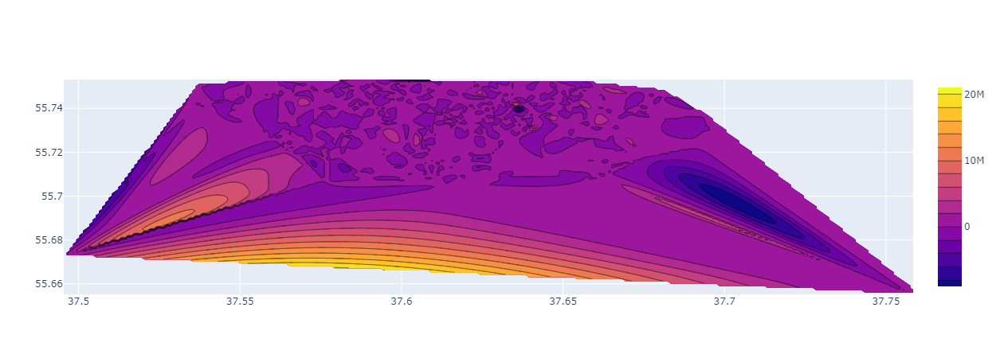

In [97]:
import plotly.graph_objects as go
# fig = go.Figure(go.Scattermapbox(
#     fill = "toself",
#     lon = [-74, -70, -70, -74], lat = [47, 47, 45, 45],
#     marker = { 'size': 10, 'colors': "orange" }))
fig = go.Figure(data=go.Contour(x = arange_x, y = arange_y, z=structured_wifi_cubic))
# fig.add_contour(x = arange_x, y = arange_y, z=structured_wifi_cubic )
# fig.update_layout(
#     mapbox = {
#         'style': "stamen-terrain",
#         'center': {'lon': 37.62248054041811, 'lat': 55.753523766159674 },
#         'zoom': 11},
#     showlegend = False,
#     width=800, height=800)
fig.show()

## Ступенчатая интерполяция

## Линейная интерполяция

## Гистограмма для пользователей

# Kernel Density (scipy)

## Гистограмма для пользователей

In [85]:
wifi_kde.shape

NameError: name 'wifi_kde' is not defined

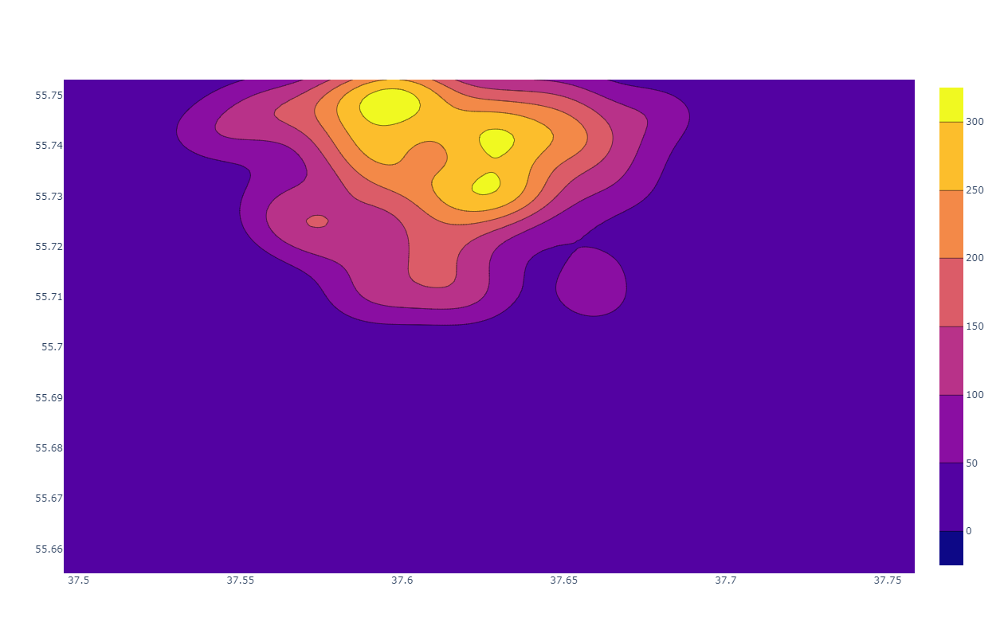

In [104]:
from scipy import stats
#positions = np.vstack([X.ravel(), Y.ravel()])
#values = np.vstack([m1, m2])

#https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.gaussian_kde.html
positions = np.vstack([target_grid_y.ravel(), target_grid_x.ravel()])
kernel_wifi = stats.gaussian_kde(dataset=points_wifi.T, weights=values_wifi)
wifi_kde = np.reshape(kernel_wifi(positions), target_grid_x.shape)
fig = go.Figure(data =go.Contour(x =arange_x, y = arange_y, z=wifi_kde ))
fig.update_layout(
    width=800, height=800)
fig.show()

## Гистограмма для фуд-ритейла

In [112]:
np.savetxt("retail_grid.txt",wifi_kde - retail_kde*20)

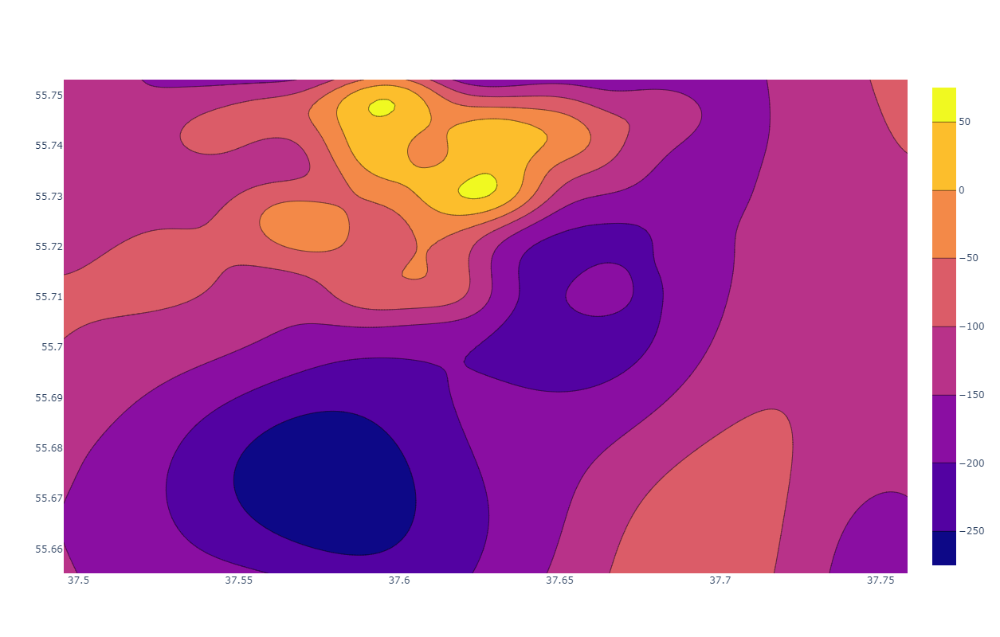

In [110]:
kernel_retail = stats.gaussian_kde(points_retail.T)#, weights=values_wifi)
retail_kde = np.reshape(kernel_retail(positions), target_grid_x.shape)
fig = go.Figure(data =go.Contour(x =arange_x, y = arange_y, z=wifi_kde - retail_kde*20 ))
fig.update_layout(
    width=800, height=800)
fig.show()

## Гистограмма для кафе/ресторанов

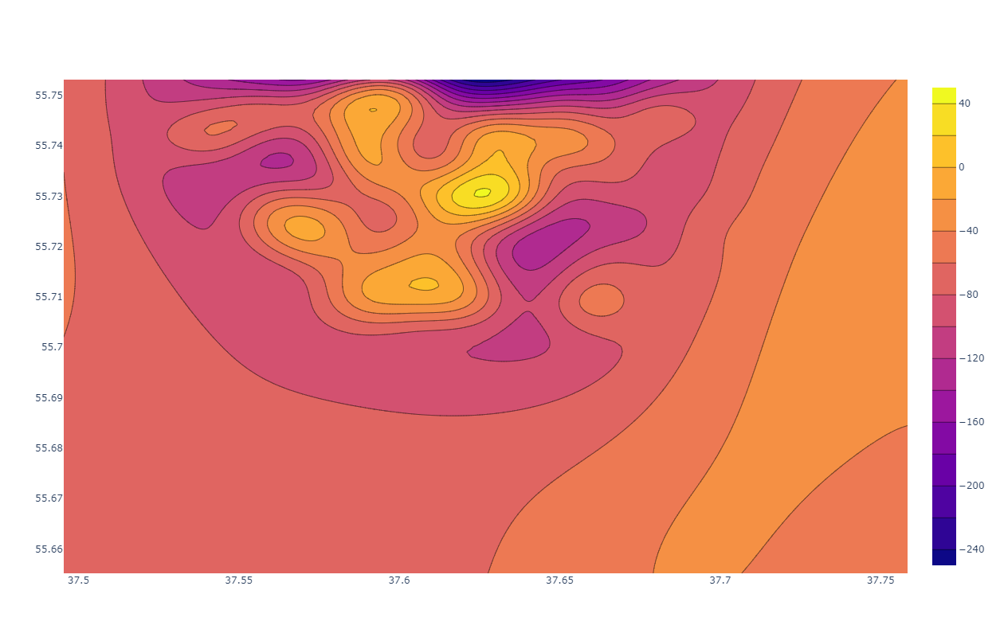

In [113]:
kernel_cafe = stats.gaussian_kde(points_cafe.T, weights=values_cafe)
kde_cafe = np.reshape(kernel_cafe(positions), target_grid_x.shape)
fig = go.Figure(data =go.Contour(x =arange_x, y = arange_y, z=wifi_kde - kde_cafe*10 ))
fig.update_layout(
    width=800, height=800)
fig.show()

In [115]:
np.savetxt("cafe_grid.txt",wifi_kde - kde_cafe*10)
np.savetxt("lat_grid.txt",arange_y)
np.savetxt("lon_grid.txt",arange_x)

In [ ]:
fig = go.Figure(data =go.Contour(x =arange_x, y = arange_y, z=wifi_kde ))
fig.update_layout(
    width=800, height=800)
fig.show()

# Test

In [38]:
from scipy import stats
def measure(n):
    "Measurement model, return two coupled measurements."
    m1 = np.random.normal(size=n)
    m2 = np.random.normal(scale=0.5, size=n)
    return m1+m2, m1-m2

m1, m2 = measure(2000)
xmin = m1.min()
xmax = m1.max()
ymin = m2.min()
ymax = m2.max()

In [39]:
X, Y = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
print("X.shape=", X.shape)
positions = np.vstack([X.ravel(), Y.ravel()]) # сетка, на которой необходимо получить значения
print("X.ravel().shape=", X.ravel().shape)
print("positions=", positions)
print("positions.shape=", positions.shape)
values = np.vstack([m1, m2])
print("values=", values)
print("values.shape=", values.shape)
kernel = stats.gaussian_kde(values)
Z = np.reshape(kernel(positions).T, X.shape)

X.shape= (100, 100)
X.ravel().shape= (10000,)
positions= [[-4.38901444 -4.38901444 -4.38901444 ...  3.68826566  3.68826566
   3.68826566]
 [-3.53365976 -3.46692636 -3.40019295 ...  2.93948044  3.00621384
   3.07294725]]
positions.shape= (2, 10000)
values= [[ 0.09626618 -1.06385787 -1.01971613 ...  2.46826034  1.70692659
   1.41668834]
 [ 1.46355332 -0.31784326 -2.64009533 ...  2.05604081  0.25677696
  -0.40576032]]
values.shape= (2, 2000)


In [ ]:
values.shape

In [ ]:
Z.shape

In [127]:
import numpy
import json
grid_lat = numpy.loadtxt("lat_grid.txt")
grid_lon = numpy.loadtxt("lon_grid.txt")
meshgrid_x, meshgrid_y = np.meshgrid(grid_lon, grid_lat)
grid_2d_cafe = numpy.loadtxt("cafe_grid.txt")

meshgrid_x_flat = meshgrid_x.flatten()
meshgrid_y_flat = meshgrid_y.flatten()
grid_2d_cafe_flat = grid_2d_cafe.flatten()

array_of_dict = []
for lat,lon, val in zip(meshgrid_x_flat,meshgrid_y_flat, grid_2d_cafe_flat):
    array_of_dict.append({"lat": lat, "lng": lon, "num": val})
json_obj = json.dumps(array_of_dict)
print(json_obj)

[{"lat": 37.49541473388672, "lng": 55.655155181884766, "num": -73.77428152088847}, {"lat": 37.496414733886716, "lng": 55.655155181884766, "num": -74.10203782519287}, {"lat": 37.497414733886714, "lng": 55.655155181884766, "num": -74.39946518488225}, {"lat": 37.49841473388671, "lng": 55.655155181884766, "num": -74.66659047967431}, {"lat": 37.49941473388671, "lng": 55.655155181884766, "num": -74.90350424363108}, {"lat": 37.50041473388671, "lng": 55.655155181884766, "num": -75.1103591613246}, {"lat": 37.501414733886705, "lng": 55.655155181884766, "num": -75.2873684377908}, {"lat": 37.5024147338867, "lng": 55.655155181884766, "num": -75.43480405987127}, {"lat": 37.5034147338867, "lng": 55.655155181884766, "num": -75.55299496603897}, {"lat": 37.5044147338867, "lng": 55.655155181884766, "num": -75.64232514103696}, {"lat": 37.505414733886695, "lng": 55.655155181884766, "num": -75.70323165072264}, {"lat": 37.50641473388669, "lng": 55.655155181884766, "num": -75.736202631516}, {"lat": 37.5074147